In [48]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
import feather
import pickle
import folium
from folium.plugins import FastMarkerCluster, HeatMap
from folium.vector_layers import Rectangle

import warnings
warnings.filterwarnings("ignore")

In [ ]:
# Read the data
merged_df = feather.read_dataframe('Datasets/merged_data.feather')

# Feature engineering part 1: Time Elapsed, Weekday

In [3]:
# Create time elapsed variable
time = pd.DatetimeIndex(merged_df['tpep_dropoff_datetime'] - merged_df['tpep_pickup_datetime'])
merged_df['trip_duration'] = time.hour * 60 + time.minute + time.second / 60
merged_df.head()

,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,fare_amount,extra,...,tip_amount,tolls_amount,total_amount,year,hour,day,month,period,condition,trip_duration
0,2014-12-10 08:46:36,2014-12-10 08:57:19,1,1.30,-73.983960,40.743340,-73.974555,40.756048,8.5,0.0,...,3.0,0.0,12.0,2014,8,10,12,M,Cloudy,10.716667
1,2014-12-10 09:16:56,2014-12-10 09:25:49,1,1.10,-73.998376,40.719674,-74.010260,40.720438,7.5,0.0,...,1.6,0.0,9.6,2014,9,10,12,M,Cloudy,8.883333
2,2014-12-10 10:55:00,2014-12-10 11:22:00,1,1.68,-73.990410,40.731270,-73.996068,40.748425,16.0,0.0,...,3.2,0.0,19.7,2014,10,10,12,M,Cloudy,27.000000
3,2014-12-10 10:36:27,2014-12-10 10:54:07,1,1.20,-73.984772,40.747895,-73.998100,40.756175,11.5,0.0,...,2.0,0.0,14.0,2014,10,10,12,M,Cloudy,17.666667
4,2014-12-10 11:31:25,2014-12-10 11:37:53,1,1.00,-73.967168,40.793447,-73.978950,40.784788,6.0,0.0,...,1.3,0.0,7.8,2014,11,10,12,M,Cloudy,6.466667


In [4]:
# add weekday attribute
merged_df['weekday'] = merged_df['tpep_pickup_datetime'].dt.weekday_name

# Preprocessing/Outliers

In [5]:
# Remove trips with 0 fare and 0 total amount
merged_df = merged_df[(merged_df['fare_amount']>0) & (merged_df['total_amount']>0)]

### Pickup and Dropoff coordinates

In [7]:
pu_coords = ['pickup_latitude', 'pickup_longitude']
do_coords = ['dropoff_latitude', 'dropoff_longitude']

In [11]:
# create an interactive geospatial graph
nycM1 = folium.Map(location=[40.66, -73.94], tiles="openstreetmap", zoom_start=10)

# use a built-in clustering algorithm to apply markers for hotspots
FastMarkerCluster(data=merged_df[pu_coords].values).add_to(nycM1)

nycM1.save('Plots/foliumPickupClustersBefore.html')

# visualize the plot 
nycM1

Define a bounding box using https://www.openstreetmap.org/export#map=11/40.7627/-73.9265 to analyse trips where the pickups were within a certain area

In [12]:
def select_within_boundingbox(df, BB):
    return (df.pickup_longitude >= BB[0]) & (df.pickup_longitude <= BB[1]) & \
           (df.pickup_latitude >= BB[2]) & (df.pickup_latitude <= BB[3]) & \
           (df.dropoff_longitude >= BB[0]) & (df.dropoff_longitude <= BB[1]) & \
           (df.dropoff_latitude >= BB[2]) & (df.dropoff_latitude <= BB[3])

BB = (-74.20, -73.71, 40.57, 40.93)
cleaned_df = merged_df[select_within_boundingbox(merged_df, BB)]
print(len(cleaned_df))

382452


In [13]:
nycM2 = folium.Map(location=[40.66, -73.94], tiles="openstreetmap", zoom_start=10)

# overlay the bounding box
points = ((BB[2], BB[0]), (BB[3], BB[0]), (BB[2], BB[1]), (BB[3], BB[1]))
folium.Rectangle(bounds=points, color='#5e36ff', fill=True, fill_color='#baddff', fill_opacity=0.3).add_to(nycM2)

FastMarkerCluster(data=cleaned_df[pu_coords].values).add_to(nycM2)
nycM2.save('Plots/foliumPickupClustersAfter.html')
nycM2

**Since the html plots will not be displayed in Github, I have posted the pictures of the plots created**
<img src="Plots/clusters_html_plots.JPG">

## Numeric variables

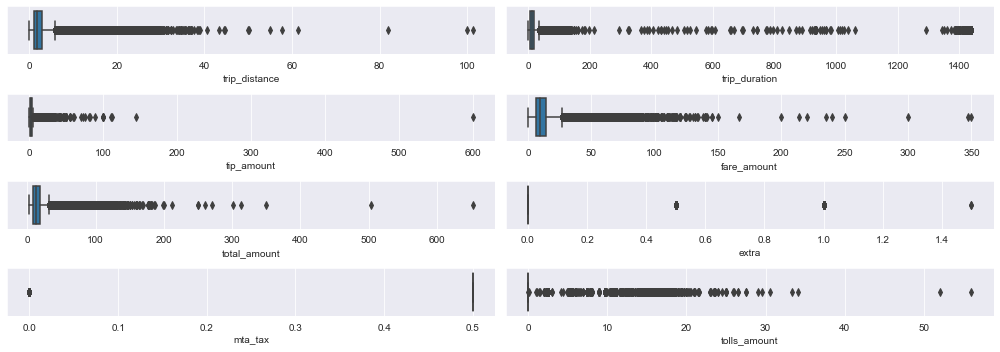

In [16]:
cols = ['trip_distance', 'trip_duration', 'tip_amount', 'fare_amount', 
        'total_amount', 'extra', 'mta_tax', 'tolls_amount']

sns.set_style('darkgrid')
f, axes = plt.subplots(4,2, figsize=(14,5))  
y = 0;
for name in cols:
    i, j = divmod(y, 2)
    sns.boxplot(x=cleaned_df[name], ax=axes[i, j])
    y = y+1

plt.tight_layout()
plt.show()

### Trip distance and trip duration

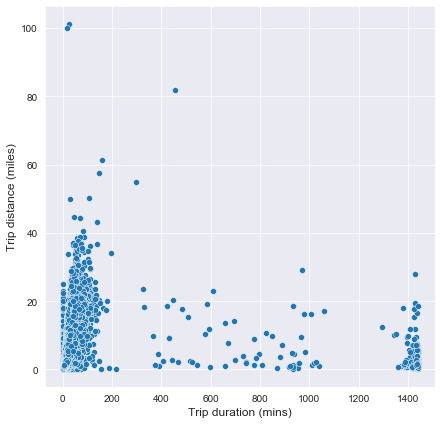

In [19]:
# It helps visualise how the trip distance varied with trip duration to identify outliers

sns.set_style('darkgrid')
plt.figure(figsize=(7,7))
sns.scatterplot(data=cleaned_df, x="trip_duration", y="trip_distance")
plt.xlabel('Trip duration (mins)', fontsize=12)
plt.ylabel('Trip distance (miles)', fontsize=12)

plt.show()

* We would expect a somewhat linear relationship between the trip distance and the duration. There appears to be a linear relationship for trip duration < 200 mins. There also seems to be a cluster at around the 1400 minutes (~24 hours). Inspecting those data entries (in another notebook) showed that these entries were indeed abnormal. They span a whole day and many of them do not have very high trip distance as we would expect for longer trips. The fare amounts also do not match.
* From https://www1.nyc.gov/site/tlc/about/fatigued-driving-prevention-frequently-asked-questions.page#:~:text=Both%20taxi%20and%20FHV%20drivers,the%20TPEP%20and%20LPEP%20systems. : <br> *How does the new fatigue prevention rule affect yellow taxi drivers?*
"Both taxi and FHV drivers are prohibited from transporting passengers for more than 10 hours in any 24-hour period and for more than 60 hours in a calendar week (Monday-Sunday)."
* Therefore I am gonna remove instances where the trip duration is > 90 mins since few trips fall outside this range and these outliers might badly affect the model. And typically taxi drivers rarely do trips that go for this long.
* It would also be reasonable to remove trips where the trip duration were less than 1 minute. These could also correspond to trips that were cancelled or the customers were kicked out.

### Average speed
Also, from https://en.wikipedia.org/wiki/Speed_limits_in_the_United_States the speed limit in New York ranges from 45 to 65. Therefore I would consider taxis who had an average_mph above 70 to be irrealistic instances. 

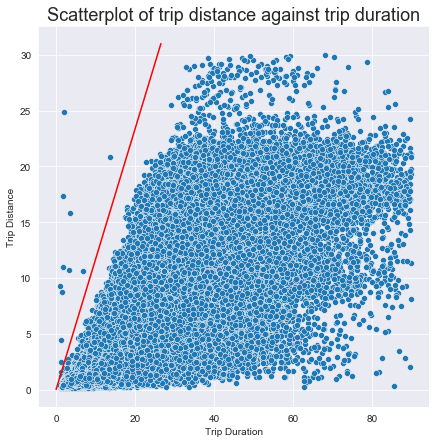

In [21]:
check = cleaned_df[(cleaned_df['trip_duration']>1) & (cleaned_df['trip_duration']<90)
                  & (cleaned_df['trip_distance']>0.1) & (cleaned_df['trip_distance']<30)]

plt.figure(figsize=(7,7))
sns.scatterplot(data=check, x="trip_duration", y="trip_distance")

Y_plot = np.linspace(0, 31, 100)
X_plot = 0.857*Y_plot # this line corresponds to the maximum speed limit of 70 mph
plt.plot(X_plot, Y_plot, color='r')
plt.title('Scatterplot of trip distance against trip duration', fontsize=18)
plt.xlabel('Trip Duration')
plt.ylabel('Trip Distance')
plt.show()

### Fare amount per mile

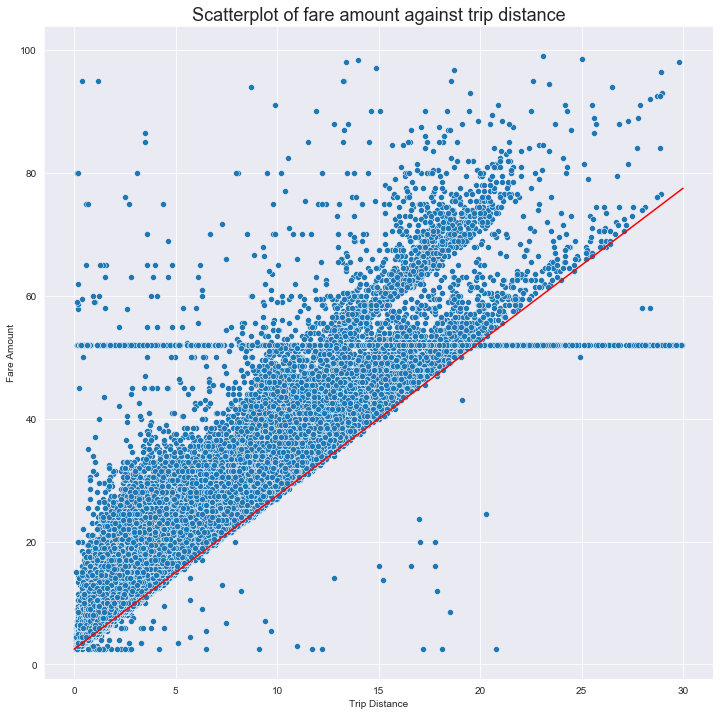

In [22]:
check = cleaned_df[(cleaned_df['fare_amount']<100)
                  & (cleaned_df['trip_distance']>0.1) & (cleaned_df['trip_distance']<30)]

plt.figure(figsize=(7,7))
sns.scatterplot(data=check, x="trip_distance", y="fare_amount")

X_plot = np.linspace(0, 30, 100)
Y_plot = 2.5+2.5*X_plot # this line corresponds to the minimum fare
plt.plot(X_plot, Y_plot, color='r')
plt.title('Scatterplot of fare amount against trip distance', fontsize=18)
plt.xlabel('Trip Distance')
plt.ylabel('Fare Amount')
plt.show()

* According to https://www1.nyc.gov/site/tlc/passengers/taxi-fare.page , there is an initial \\$2.50 charge and \\$0.50 per 1/5 mile (==\\$2.5 per mile). I want to remove instances where these were below this amount. 
* There also seems to be instances where the fare amount was fixed at around \\$52 regardless of the trip distance. These probably correspond to fixed prices for airport trips. I did not remove those ones but it is worthwhile to note that they have higher tip amounts in general (checked in another notebook)

In [23]:
# Remove the outliers

bef = len(cleaned_df)
print("BEFORE REMOVAL OF OUTLIERS: ", bef)

# Trip distance
cleaned_df = cleaned_df[cleaned_df['trip_distance']<=30]
cleaned_df = cleaned_df[cleaned_df['trip_distance']>0.1]

# Trip duration
cleaned_df = cleaned_df[(cleaned_df['trip_duration']>1) & (cleaned_df['trip_duration']<90)]

# average speed
cleaned_df['average_mph'] = cleaned_df['trip_distance']/(cleaned_df['trip_duration']/60) 
cleaned_df = cleaned_df[cleaned_df['average_mph']<70] # only consider trips which had an average of 70 mph or below 
cleaned_df.drop('average_mph', axis=1, inplace=True) # Remove the column

# Passenger count
cleaned_df = cleaned_df[cleaned_df['passenger_count']!=0]

# Tip amount
cleaned_df = cleaned_df[cleaned_df['tip_amount']<=40]

# Fare amount
cleaned_df=cleaned_df[cleaned_df['fare_amount']<100]
invalid = cleaned_df['fare_amount'] > 2.25 + cleaned_df['trip_distance'] * 2.5 #allow a certain margin for discounts
cleaned_df = cleaned_df[invalid]

# Total amount
cleaned_df=cleaned_df[cleaned_df['total_amount']<180]

# Tolls amount
cleaned_df=cleaned_df[cleaned_df['tolls_amount']<21]  

# Extra
cleaned_df=cleaned_df[cleaned_df['extra'].isin([0,0.5,1])]  

aft = len(cleaned_df)
print("AFTER REMOVAL OF OUTLIERS: ", aft)
print("NUMBER OF OUTLIERS: ", bef-aft)

BEFORE REMOVAL OF OUTLIERS:  382452
AFTER REMOVAL OF OUTLIERS:  376166
NUMBER OF OUTLIERS:  6286


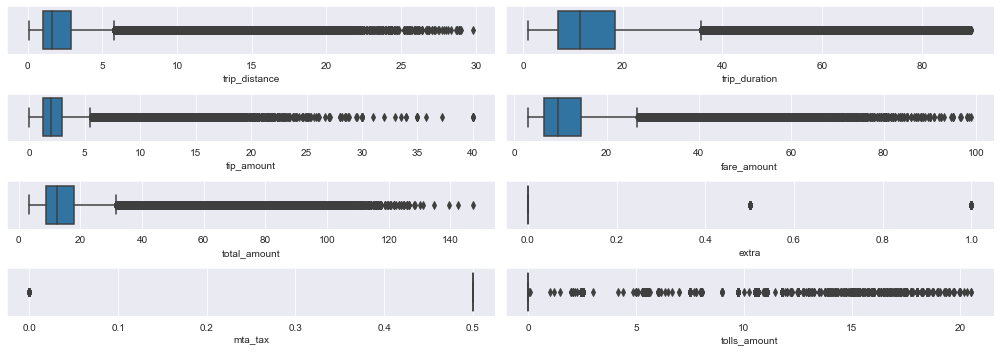

In [24]:
f, axes = plt.subplots(4,2, figsize=(14,5))  
y = 0;
for name in cols:
    i, j = divmod(y, 2)
    sns.boxplot(x=cleaned_df[name], ax=axes[i, j])
    y = y+1

plt.tight_layout()
plt.show()

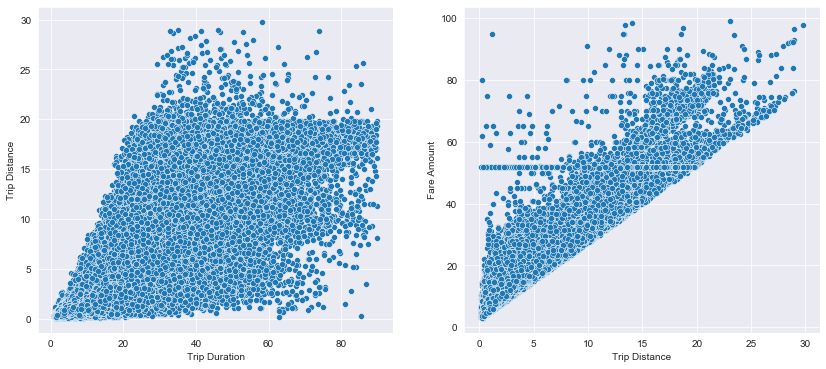

In [28]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(14,6))
sns.scatterplot(data=cleaned_df, ax=ax1, x="trip_duration", y="trip_distance")
ax1.set_xlabel('Trip Duration')
ax1.set_ylabel('Trip Distance')

sns.scatterplot(data=cleaned_df, ax=ax2, x="trip_distance", y="fare_amount")
ax2.set_xlabel('Trip Distance')
ax2.set_ylabel('Fare Amount')

plt.show()

## Categorical variables

In [29]:
print(cleaned_df['passenger_count'].value_counts())
print("\n")
print(cleaned_df['condition'].value_counts())
print("\n")
print(cleaned_df['hour'].value_counts())
print("\n")
print(cleaned_df['weekday'].value_counts())

1    274661
2     47743
5     20751
6     13747
3     13269
4      5995
Name: passenger_count, dtype: int64


Sunny     179163
Cloudy    148298
Rain       25296
Fog        23409
Name: condition, dtype: int64


17    35679
14    34801
8     34739
9     34306
12    34033
13    33904
15    33546
11    32476
10    31735
16    29213
7     26990
6     14744
Name: hour, dtype: int64


Wednesday    60627
Thursday     58683
Tuesday      57642
Friday       56783
Monday       50655
Saturday     48214
Sunday       43562
Name: weekday, dtype: int64


In [30]:
# Save the cleaned dataset

cleaned_df = cleaned_df.reset_index(drop=True)
print(len(cleaned_df))
# Save file to feather
cleaned_df.to_feather('Datasets/cleaned_data.feather')

376166


# Feature engineering part 2: Regional cluster

In [31]:
# Read the data
clustered_df = feather.read_dataframe('Datasets/cleaned_data.feather')

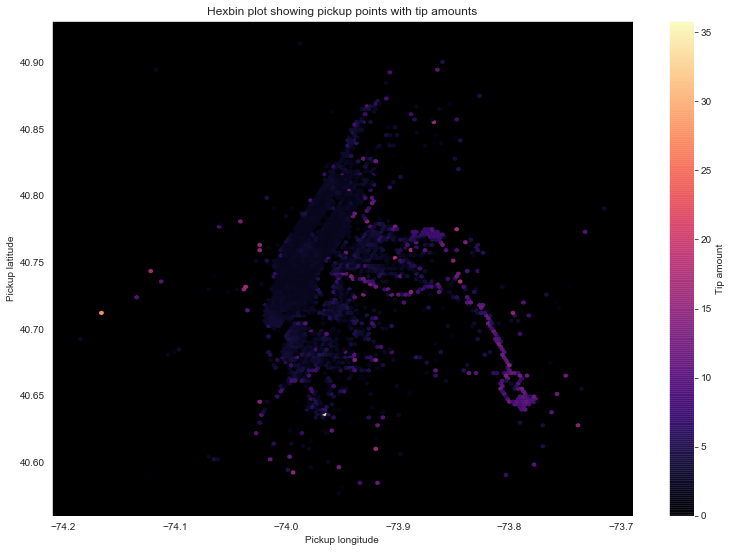

In [32]:
sns.set_style('dark')

check = cleaned_df#[cleaned_df['tip_amount']<10]
fig = check.plot.hexbin(x='pickup_longitude', y='pickup_latitude', C='tip_amount',
                       gridsize=150, cmap="magma", alpha=0.9,
                            sharex=False, figsize=(13,9.1))
fig.set_facecolor('black')

plt.xlabel('Pickup longitude')
plt.ylabel('Pickup latitude')
plt.title('Hexbin plot showing pickup points with tip amounts')
f = plt.gcf()
cax = f.get_axes()[1]
cax.set_ylabel('Tip amount')

plt.savefig('Plots/tips_hex150_white.png')

plt.show()

* Regions at the airport tend to give higher tips
* The highest tips region tend to happen outside manhattan (need to talk more)

### Cluster points according to tips per mile using K means
I will group the pick-up coordinates into clusters with tip amounts as weight using K-means algorithm so as to be used as a categorical attribute. To find the optimal number of clusters, I plotted elbow curves for the inertia and distortions.

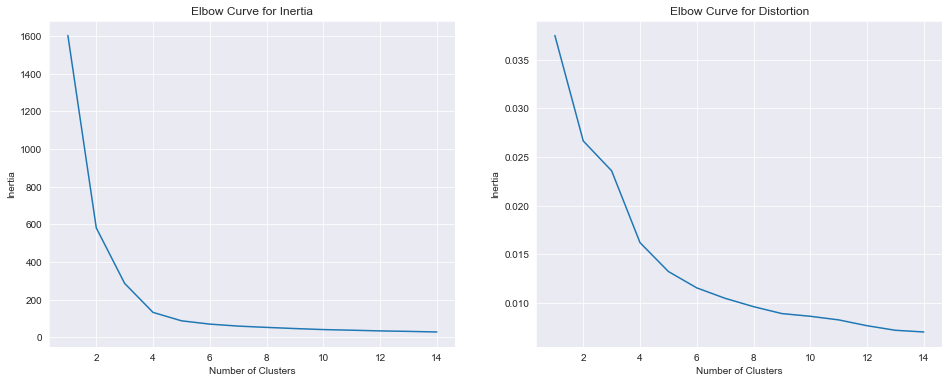

In [43]:
# Plot an elbow curve to determine the best K
K_clusters = range(1,15)

kmeans = [KMeans(n_clusters=i, random_state=30034) for i in K_clusters]
km = [kmeans[i].fit(clustered_df[pu_coords], 
                       sample_weight=clustered_df['tip_amount']) for i in range(len(kmeans))]

inertias = [km[i].inertia_ for i in range(len(km))]
distortions = [sum(np.min(cdist(clustered_df[pu_coords], km[i].cluster_centers_, 
                      'euclidean'),axis=1)) / clustered_df.shape[0] for i in range(len(kmeans))]    

# Visualise 
sns.set_style("darkgrid")
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,6))
ax1.plot(K_clusters, inertias)
ax1.set_xlabel('Number of Clusters')
ax1.set_ylabel('Inertia')
ax1.set_title('Elbow Curve for Inertia')

ax2.plot(K_clusters, distortions)
ax2.set_xlabel('Number of Clusters')
ax2.set_ylabel('Inertia')
ax2.set_title('Elbow Curve for Distortion')

plt.show()

In [44]:
def plot_clusters(K, df, kmeans):
    
    pu_coords = ['pickup_latitude', 'pickup_longitude']
    
    df['cluster'] = kmeans.labels_
    
    sns.set_style('white')
    plt.style.use(['dark_background'])
    fig, ax = plt.subplots(figsize = (7.5,5))

    for cluster in range(K):
        cluster_coords = df.loc[df['cluster'] == cluster, pu_coords]
        ax.plot(cluster_coords['pickup_longitude'], cluster_coords['pickup_latitude'], '.', markersize=2)
        center = kmeans.cluster_centers_[cluster]
        ax.plot(center[1], center[0], 'o', color='red', markersize=5)
        ax.annotate(cluster, (center[1], center[0]), color = 'red', fontsize = 20)
    
    plt.title(f"Plot of Pickups into (k={K}) clusters with annotation")
    plt.savefig(f"Plots/{K}_clusters.png")
    plt.show()

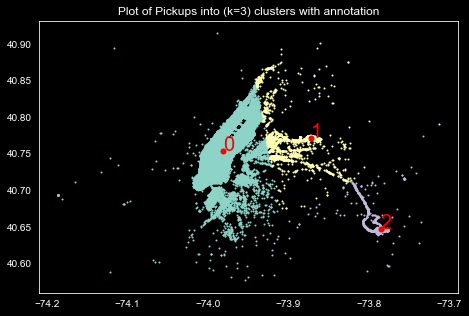

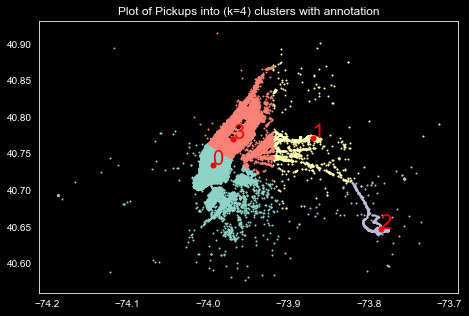

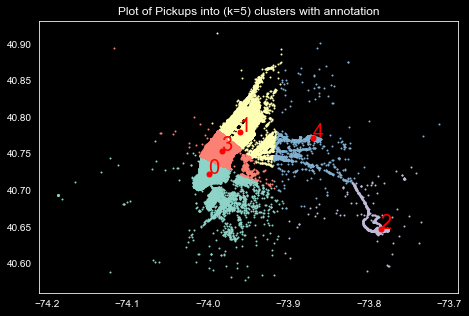

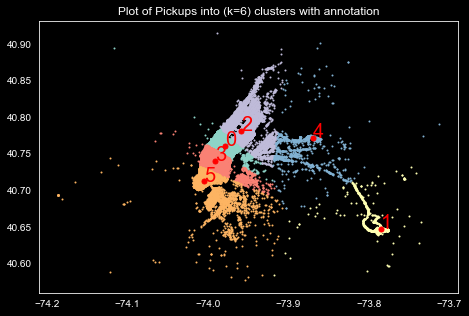

In [45]:
for k in range(3,7):
    plot_clusters(k, clustered_df, km[k-1])

In [46]:
def group_stats(k, df, km):
    df['cluster'] = km.labels_
    return df.groupby('cluster')['trip_distance', 'fare_amount',
                                    'tip_amount','trip_duration'].mean()

for k in range(3,7):
    print(f"NUMBER OF CLUSTERS = {k}")
    print(group_stats(k, clustered_df, km[k-1]))
    print("\n")

NUMBER OF CLUSTERS = 3
         trip_distance  fare_amount  tip_amount  trip_duration
cluster                                                       
0             2.406107    11.612933    2.319585      13.400327
1             9.233508    31.168095    6.699401      31.987557
2            16.015246    47.702688    9.031096      45.782428


NUMBER OF CLUSTERS = 4
         trip_distance  fare_amount  tip_amount  trip_duration
cluster                                                       
0             2.433299    11.781161    2.350782      13.707387
1             9.525238    31.974960    6.903852      32.849408
2            16.026560    47.720093    9.033720      45.818167
3             2.391182    11.496272    2.297382      13.158642


NUMBER OF CLUSTERS = 5
         trip_distance  fare_amount  tip_amount  trip_duration
cluster                                                       
0             2.701079    12.477855    2.454223      14.338916
1             2.322203    11.124426    2.1681

From the elbow curves, we conclude k=5 is the best number of clusters. Also the different clusters correspond to these areas: 
* cluster 0: Lower Manhattan
* cluster 1: Upper Manhattan
* cluster 2: JFK Airport
* cluster 3: Middle Manhattan (Times Square)
* cluster 4: La Guardia Airport

In [ ]:
# save the model
pickle.dump(kmeans[4], open("kmeans_model.pkl", "wb"))  # corresponds to k=5

In [65]:
# load the model
kmeans = pickle.load(open("kmeans_model.pkl", "rb"))

In [51]:
clustered_df['cluster'] = kmeans.labels_

### Convert tip amount into 3 levels
I also decided to assign three different levels to the tip amounts so as to be used in a classification model instead of a regression model. This is to deal with the large amount of outliers in the dataset and to improve the strength of prediction. Clustering the tip amount into levels will reduce the effect of outliers on the significance of the predictive model. To be able to decide the boundaries of each level, it would be useful to see its distribution. 

In [52]:
clustered_df['tip_amount'].describe()

count    376166.000000
mean          2.583552
std           2.381176
min           0.000000
25%           1.250000
50%           1.960000
75%           2.950000
max          40.000000
Name: tip_amount, dtype: float64

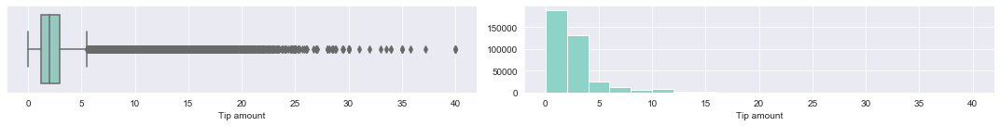

In [53]:
cols = ['trip_distance', 'trip_duration', 'tip_amount', 'fare_amount', 
        'total_amount', 'extra', 'mta_tax', 'tolls_amount']

sns.set_style('darkgrid')
f, (ax1,ax2) = plt.subplots(1,2, figsize=(15,2))  
sns.boxplot(x=clustered_df['tip_amount'], ax=ax1).set(xlabel='Tip amount')
ax2.hist(clustered_df['tip_amount'], bins=20)
ax2.set_xlabel('Tip amount')
plt.tight_layout()
plt.show()

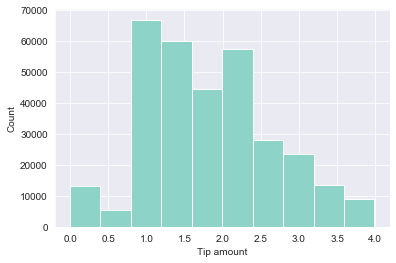

In [55]:
plt.hist(clustered_df[clustered_df['tip_amount']<4]['tip_amount'])
plt.xlabel('Tip amount')
plt.ylabel("Count")
plt.show()

In [56]:
tips = clustered_df['tip_amount'].sort_values().reset_index(drop=True)
print("33% quantile: ", tips[len(tips)//3])
print("66% quantile: ", tips[2*(len(tips)//3)])

33% quantile:  1.5
66% quantile:  2.45


In [57]:
def print_count(tips, lower, upper):
    if upper==-1:
        # when just want to specify max
        print(f"Tips higher than or equal to {lower}: {sum(tips>lower)}")
        return
    print(f"Tips between {lower} (inclusive) and {upper}: {sum((cleaned_df['tip_amount']>=lower) & (cleaned_df['tip_amount']<upper))}")
          
print_count(clustered_df['tip_amount'], 0,1.5)
print_count(clustered_df['tip_amount'], 1.5,3)
print_count(clustered_df['tip_amount'], 3,-1)

Tips between 0 (inclusive) and 1.5: 121717
Tips between 1.5 (inclusive) and 3: 162863
Tips higher than or equal to 3: 83783


I want the clusters to contain fairly the same amount of instances so as to reduce the bias in the model. I will categorise them as:
* Level 1: Low tip (\\$0.00 - \\$1.50)
* Level 2: Medium tip (\\$1.50 - \\$3.00)
* Level 3: High tip (>\\$3.00)

In [60]:
tips = []
for i in clustered_df['tip_amount'].values:
    if i<1.5:
        tips.append(1)
    elif ((i>=1.5) & (i<3)):
        tips.append(2)
    else:
        tips.append(3)
        
clustered_df['tip_level'] = tips
clustered_df['tip_level'] = clustered_df['tip_level'].apply(str)

In [62]:
# Save the new dataset with the 3 levels of tip amounts
clustered_df.to_feather('Datasets/5clusters.feather')